In [1]:
import anndata
import scvi
import scanpy as sc
import numpy as np
import os

# can set the DPI on save here
sc.set_figure_params(figsize=(6, 6), frameon=False)
sc.settings.n_jobs=2

/home/ratopin/miniconda3/envs/scanpy-env/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Dataset preprocessing

See main_preprocessing to see preprocessing steps

### Load data

Scanpy has a number of [methods](https://scanpy.readthedocs.io/en/stable/api/index.html#reading) to load data from popular formats, including files outputted by Cell Ranger.

In [2]:
rev_n = 14
region = 'cerebral_cortex'
path_to_data = f"/home/ratopin/big_data/combined/{region}_combined_outer_adata{rev_n}.h5ad"


In [3]:
adata = sc.read_h5ad(path_to_data)
print(adata)

AnnData object with n_obs × n_vars = 49236 × 19286
    obs: 'species', 'sample_id', 'region', 'donor_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_tf', 'log1p_total_counts_tf', 'pct_counts_tf', 'n_counts', 'qc_composite', 'qc_label', 'suspension_type', 'dissection', 'total_UMIs', 'cluster_id', 'roi', 'dataset_source', 'stage', 'Major Field', 'Supercluster', 'Specific', 'Top Enriched Genes', 'Age', 'CellClass', 'Region', 'Subregion', 'cell_cycle_score', 'total_genes', 'dataset'
    var: 'mt-human_adult', 'ribo-human_adult', 'n_cells_by_counts-human_adult', 'mean_counts-human_adult', 'log1p_mean_counts-human_adult', 'pct_dr

In [4]:
adata.obs_names_make_unique()

In [5]:
adata

AnnData object with n_obs × n_vars = 49236 × 19286
    obs: 'species', 'sample_id', 'region', 'donor_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_tf', 'log1p_total_counts_tf', 'pct_counts_tf', 'n_counts', 'qc_composite', 'qc_label', 'suspension_type', 'dissection', 'total_UMIs', 'cluster_id', 'roi', 'dataset_source', 'stage', 'Major Field', 'Supercluster', 'Specific', 'Top Enriched Genes', 'Age', 'CellClass', 'Region', 'Subregion', 'cell_cycle_score', 'total_genes', 'dataset'
    var: 'mt-human_adult', 'ribo-human_adult', 'n_cells_by_counts-human_adult', 'mean_counts-human_adult', 'log1p_mean_counts-human_adult', 'pct_dr

### Quality control

In [6]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'

In [7]:
adata.var['mt'].value_counts()

mt
False    19275
True        11
Name: count, dtype: int64

In [8]:
adata.var[['mt-human_adult', 'mt-human_dev', 'mt-nmr']].value_counts()

mt-human_adult  mt-human_dev  mt-nmr
False           False         False     19273
True            True          True          9
False           False         True          2
                True          True          2
Name: count, dtype: int64

In [9]:
adata.var.drop(columns=['mt-human_adult', 'mt-human_dev', 'mt-nmr'], axis=1, inplace=True)

In [10]:
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [11]:
adata.obs.head()

,species,sample_id,region,donor_id,n_genes_by_counts,log1p_n_genes_by_counts,total_counts,log1p_total_counts,pct_counts_in_top_50_genes,pct_counts_in_top_100_genes,...,Supercluster,Specific,Top Enriched Genes,Age,CellClass,Region,Subregion,cell_cycle_score,total_genes,dataset
AAACCCAAGAAGCGAA-1-NMR1,nmr,NMR1,cerebral cortex,ratopin1,1556,7.352441,2295.0,7.740230,14.882507,22.062663,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nmr
AAACCCAAGGAGGCAG-1-NMR1,nmr,NMR1,cerebral cortex,ratopin1,1310,7.180070,1775.0,7.483244,14.350028,21.890827,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nmr
AAACCCACAAATCAAG-1-NMR1,nmr,NMR1,cerebral cortex,ratopin1,489,6.198479,677.0,6.522093,29.602356,42.415317,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nmr
AAACCCACAGTCTACA-1-NMR1,nmr,NMR1,cerebral cortex,ratopin1,1837,7.518607,3362.0,8.122668,19.709112,27.634313,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nmr
AAACCCAGTACGTAGG-1-NMR1,nmr,NMR1,cerebral cortex,ratopin1,477,6.171701,709.0,6.566672,32.535211,46.760563,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,nmr


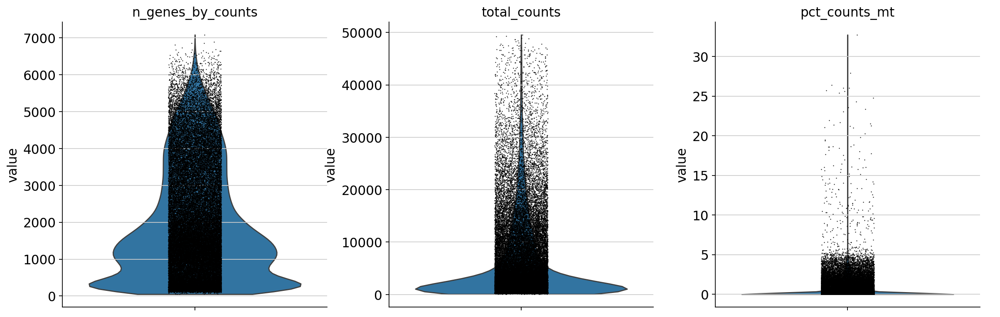

In [12]:
sc.pl.violin(
    adata,
    [
     'n_genes_by_counts',
     'total_counts',
     'pct_counts_mt'
     ],
    multi_panel=True
)

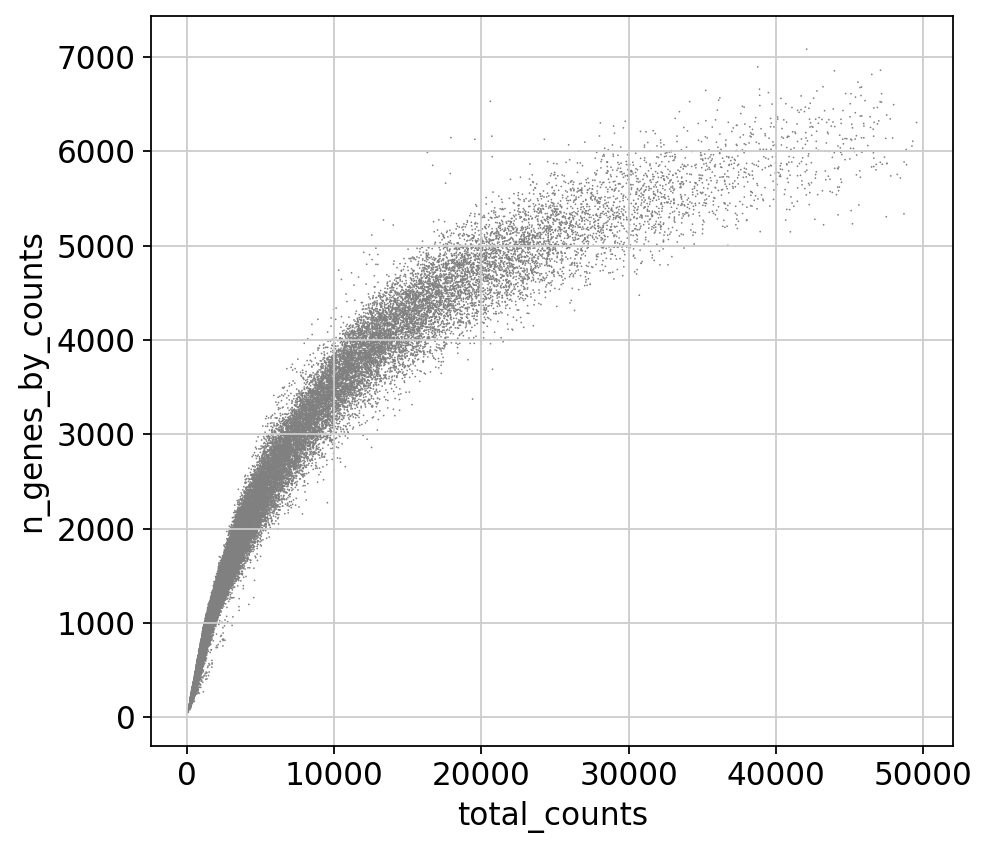

In [13]:
sc.pl.scatter(adata, "total_counts", "n_genes_by_counts")

In [14]:
# example
# adata = adata[adata.obs.pct_counts_mt < 15]

### Normalization

Here we use a series of steps to preserve the count data for later, and the log normalized data.

In [15]:
adata.layers["counts"] = adata.X.copy() # preserve counts
sc.pp.normalize_total(adata, target_sum=1e4) # scale each cell to a common library size
sc.pp.log1p(adata) # log(expression + 1)
adata.raw = adata # freeze the state in `.raw`

In [16]:
sc.pp.highly_variable_genes(
    adata,
    n_top_genes=4000,
    # subset=True, # to automatically subset to the 5000 genes
    layer="counts",
    flavor="seurat_v3"
)

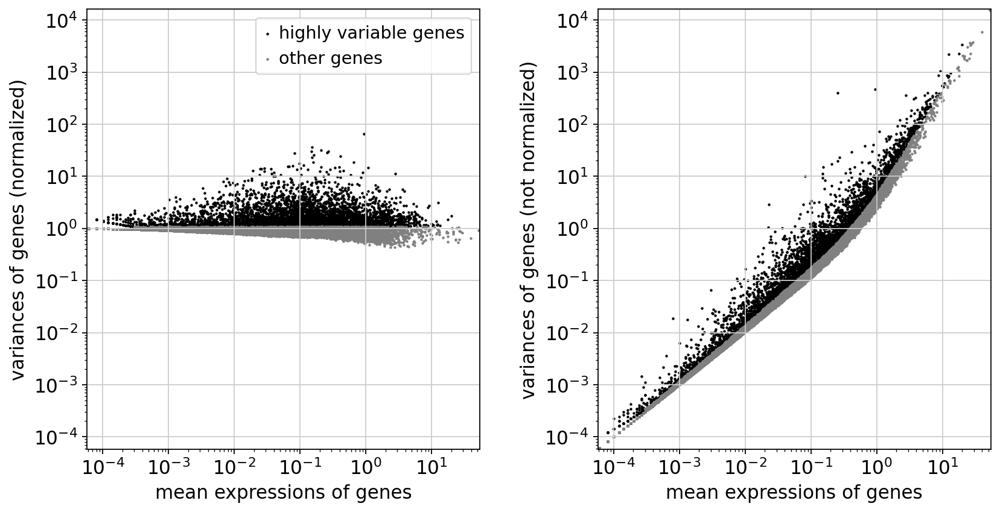

In [17]:
sc.pl.highly_variable_genes(adata, log=True)

In [18]:
# subset to highly variable genes
bdata = adata.copy()
adata = adata[:, adata.var.highly_variable].copy()

In [19]:
adata

AnnData object with n_obs × n_vars = 49236 × 4000
    obs: 'species', 'sample_id', 'region', 'donor_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_tf', 'log1p_total_counts_tf', 'pct_counts_tf', 'n_counts', 'qc_composite', 'qc_label', 'suspension_type', 'dissection', 'total_UMIs', 'cluster_id', 'roi', 'dataset_source', 'stage', 'Major Field', 'Supercluster', 'Specific', 'Top Enriched Genes', 'Age', 'CellClass', 'Region', 'Subregion', 'cell_cycle_score', 'total_genes', 'dataset'
    var: 'ribo-human_adult', 'n_cells_by_counts-human_adult', 'mean_counts-human_adult', 'log1p_mean_counts-human_adult', 'pct_dropout_by_counts-hum

In [20]:
adata.raw.to_adata()

AnnData object with n_obs × n_vars = 49236 × 19286
    obs: 'species', 'sample_id', 'region', 'donor_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_tf', 'log1p_total_counts_tf', 'pct_counts_tf', 'n_counts', 'qc_composite', 'qc_label', 'suspension_type', 'dissection', 'total_UMIs', 'cluster_id', 'roi', 'dataset_source', 'stage', 'Major Field', 'Supercluster', 'Specific', 'Top Enriched Genes', 'Age', 'CellClass', 'Region', 'Subregion', 'cell_cycle_score', 'total_genes', 'dataset'
    var: 'ribo-human_adult', 'n_cells_by_counts-human_adult', 'mean_counts-human_adult', 'log1p_mean_counts-human_adult', 'pct_dropout_by_counts-hu

## SCANVI label transfer

In [21]:
adata.obs['Supercluster'] = adata.obs['Supercluster'].cat.add_categories(['Unknown'])
adata.obs['Supercluster'] = adata.obs['Supercluster'].fillna('Unknown')

In [22]:
scvi.model.SCANVI.setup_anndata(adata, layer="counts",
                                categorical_covariate_keys=['species', 'region','donor_id'],
                                continuous_covariate_keys= ['n_genes_by_counts','total_counts','pct_counts_mt','pct_counts_ribo'],
                                batch_key='dataset', 
                                labels_key='Supercluster', 
                                unlabeled_category='Unknown')

In [23]:
scanvi_model = scvi.model.SCANVI(adata)


In [24]:
scanvi_model

ScanVI Model with the following params: 
unlabeled_category: Unknown, n_hidden: 128, n_latent: 10, n_layers: 1, dropout_rate: 0.1, dispersion: gene, 
gene_likelihood: zinb
Training status: Not Trained
Model's adata is minified?: False

In [25]:
if os.path.exists(f"{region}{rev_n}_scanvi"):
    scanvi_model = scvi.model.SCANVI.load(f"{region}{rev_n}_scanvi", adata)
    print("Model loaded from disk.")
else:
    print("No saved model found, creating a new one.")
    scanvi_model = scvi.model.SCANVI(adata)
    scanvi_model.train( max_epochs=20, train_size = 0.85,
                       # categorical_covariate_keys=['species','donor_id']
                       )
    scanvi_model.save(f"{region}{rev_n}_scanvi", overwrite=True)


No saved model found, creating a new one.
INFO     Training for 20 epochs.                                                                                   


GPU available: False, used: False
TPU available: False, using: 0 TPU cores
/home/ratopin/miniconda3/envs/scanpy-env/lib/python3.12/site-packages/lightning/pytorch/utilities/_pytree.py:21: `isinstance(treespec, LeafSpec)` is deprecated, use `isinstance(treespec, TreeSpec) and treespec.is_leaf()` instead.
/home/ratopin/miniconda3/envs/scanpy-env/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:434: The 'train_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=103` in the `DataLoader` to improve performance.


Epoch 20/20: 100%|██████████| 20/20 [05:08<00:00, 15.23s/it, v_num=1, train_loss=1.38e+3]

`Trainer.fit` stopped: `max_epochs=20` reached.


Epoch 20/20: 100%|██████████| 20/20 [05:08<00:00, 15.42s/it, v_num=1, train_loss=1.38e+3]


In [26]:
adata.obsm['X_scVI'] = scanvi_model.get_latent_representation()
adata.layers['X_scVI_normalized'] = scanvi_model.get_normalized_expression(library_size=1e4)


##

In [28]:
adata

AnnData object with n_obs × n_vars = 31043 × 4000
    obs: 'species', 'sample_id', 'region', 'donor_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_tf', 'log1p_total_counts_tf', 'pct_counts_tf', 'n_counts', 'qc_composite', 'qc_label', 'suspension_type', 'dissection', 'total_UMIs', 'cluster_id', 'roi', 'dataset_source', 'stage', 'Major Field', 'Supercluster', 'Specific', 'Top Enriched Genes', 'Age', 'CellClass', 'Region', 'Subregion', 'cell_cycle_score', 'total_genes', 'dataset', '_scvi_batch', '_scvi_labels'
    var: 'ribo-human_adult', 'n_cells_by_counts-human_adult', 'mean_counts-human_adult', 'log1p_mean_counts-human_adu

In [27]:
adata.obs['Supercluster_pred'] = scanvi_model.predict(adata)


In [28]:
adata.obsm["X_scANVI"] = scanvi_model.get_latent_representation(adata)

In [29]:
sc.pp.neighbors(adata, use_rep="X_scANVI", metric="correlation", n_neighbors = 35)
sc.tl.umap(adata, min_dist=0.4)

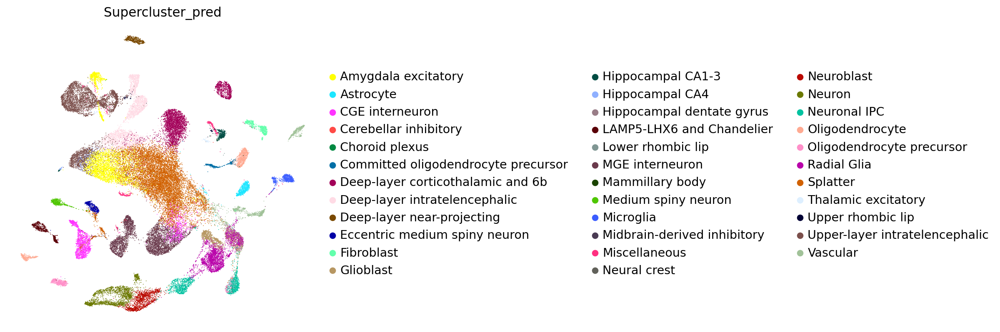

In [30]:
sc.pl.umap(adata, color = ['Supercluster_pred', ])

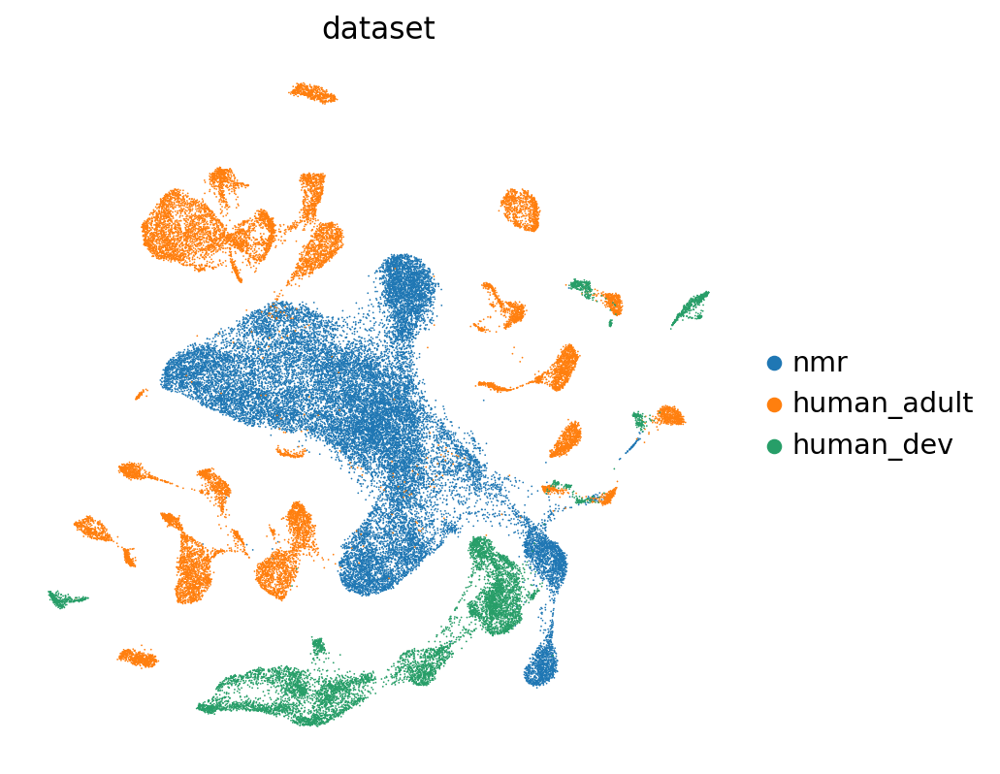

In [31]:
sc.pl.umap(adata, color = ['dataset', ])

In [33]:
#subset only NMR data
nmr_adata = adata[adata.obs['dataset']=='nmr',:].copy()

In [319]:
!ls

 cell_filtering_by_qc_clustering.py	       gene_lists
 cerebral_cortex10_scanvi		       main_preprocessing.ipynb
 cerebral_cortex10_scvi			       nmr_analysis_scvi.ipynb
 cerebral_cortex11_scanvi		       __pycache__
 cerebral_cortex11_scvi			       scanvi_label_transfer.ipynb
'def normalize_special_summary(qc_adata, .r'   scanvi_part.ipynb
 figures				       step_by_step_CrossTransfer.ipynb
'filter_by _qc_clusters.ipynb'


/tmp/ipykernel_2797090/524769499.py:1: FutureWarning: Argument `save` is deprecated and will be removed in a future version. Use `sc.pl.plot(show=False).figure.savefig()` instead.
  sc.pl.umap(nmr_adata, color='Supercluster_pred', title='scANVI Cell-type prediction', save=f'_{region}_v{rev_n}_scANVI_cell_type_pred_only_NMR.png')


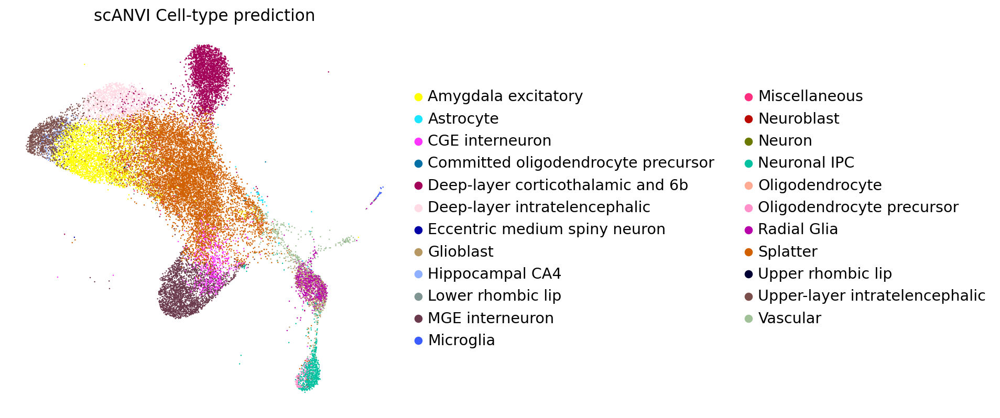

In [34]:
sc.pl.umap(nmr_adata, color='Supercluster_pred', title='scANVI Cell-type prediction', save=f'_{region}_v{rev_n}_scANVI_cell_type_pred_only_NMR.png')

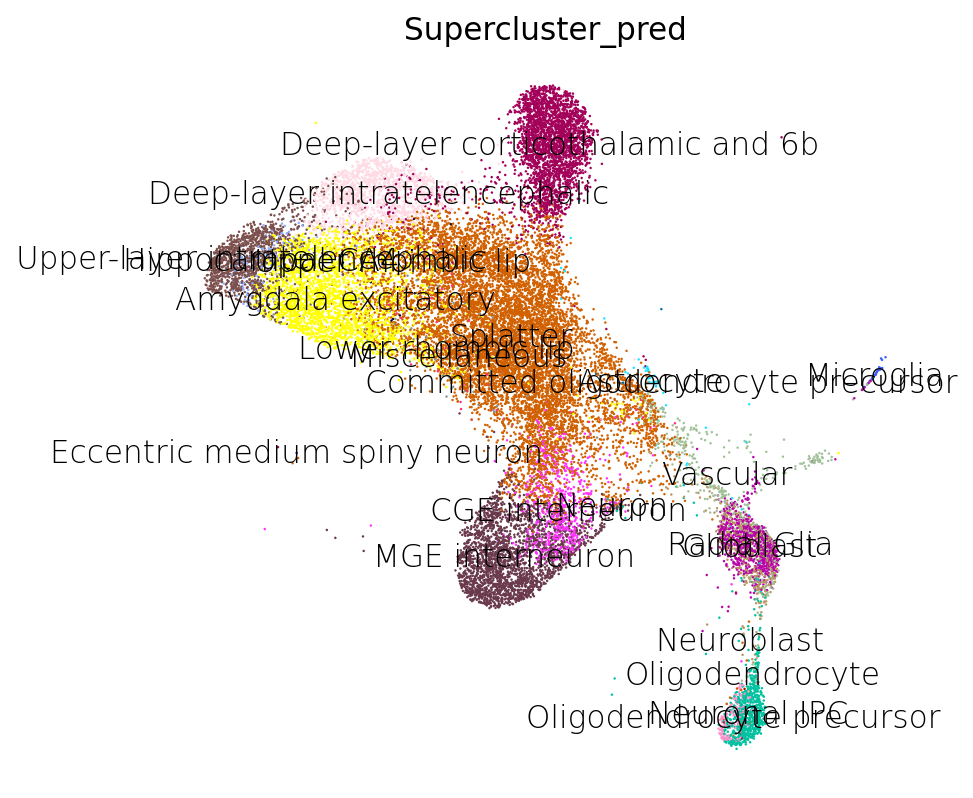

In [35]:
sc.pl.umap(nmr_adata, color='Supercluster_pred', legend_loc = 'on data', legend_fontweight=2)

In [36]:
sc.tl.dendrogram(nmr_adata, groupby="Supercluster_pred", use_rep="X_scANVI")


In [37]:
literature_markers= {
    'Neural progenitor': ['MKI67', 'TOP2A', 'UBE2C', 'RRM2', 'CDCA3', 'TPX2'], # not found: 'CCNA2', 'HMGB2' , 'PKB',
    'Neuroblast':['DLX2', 'SOX11'],
    'Glutamatergic':['PROX1'], # not found 'PLEKAHA2'
    'Neuron':['SLC17A7', 'COL5A2'],
    'GABAergic':['GAD1','GAD2'],
    'Astrocyte':['GFAP', 'AQP4'],
    'Endothelial':['FLT1', 'ENG'],
    'Oligodendrocyte precursor':['PDGFRA', 'OLIG1'],
    'Newly formed oligodendrocyte':['OLIG2','SOX10'],
    'Oligodendrocyte':['MOG','MAG']

}

categories: Amygdala excitatory, Astrocyte, CGE interneuron, etc.
var_group_labels: Neural progenitor, Neuroblast, Glutamatergic, etc.


/tmp/ipykernel_2797090/3837828361.py:1: FutureWarning: Argument `save` is deprecated and will be removed in a future version. Use `sc.pl.plot(show=False).figure.savefig()` instead.
  sc.pl.dotplot(


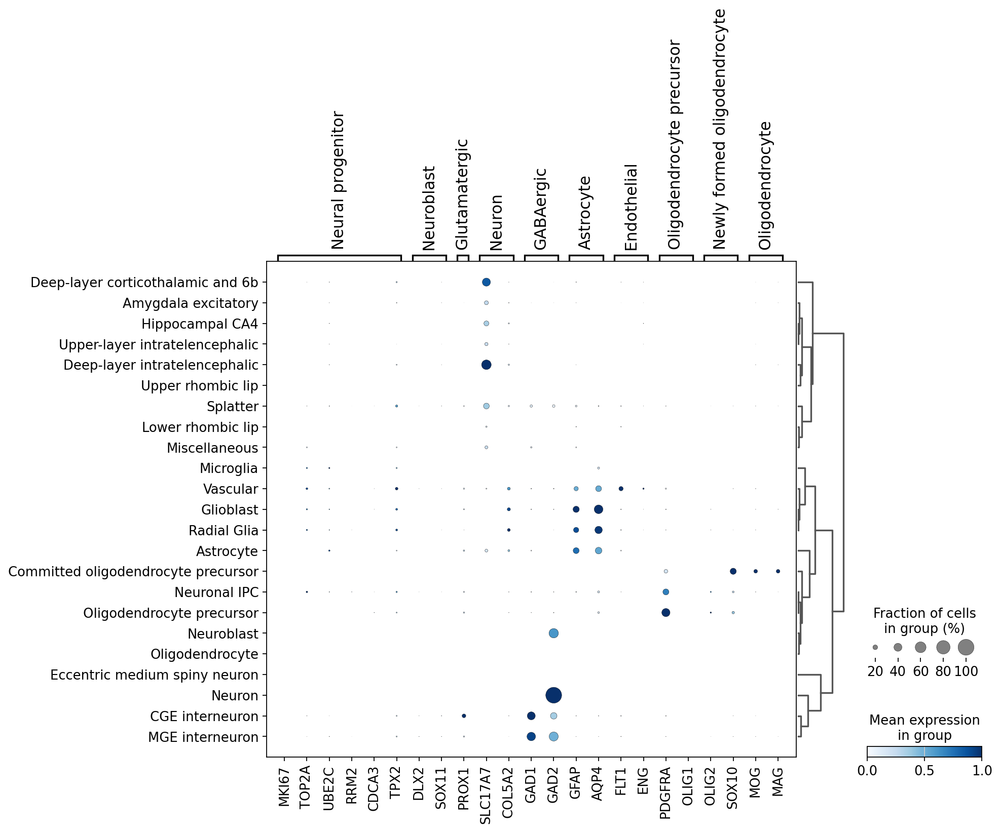

In [38]:
sc.pl.dotplot(
    nmr_adata,
    literature_markers,
    groupby='Supercluster_pred',
    dendrogram=True,
    color_map="Blues",
    swap_axes=False,
    use_raw=True,
    standard_scale="var",
    save=f'{region}_v{rev_n}_literature_markers.png'
)

In [39]:
bdata.var[bdata.var_names.str.startswith('PLP', 
                                         #case= False
                                         )]

,ribo-human_adult,n_cells_by_counts-human_adult,mean_counts-human_adult,log1p_mean_counts-human_adult,pct_dropout_by_counts-human_adult,total_counts-human_adult,log1p_total_counts-human_adult,n_cells-human_adult,global_name-human_adult,Chromosome-human_adult,...,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,highly_variable_rank,means,variances,variances_norm
global_name,,,,,,,,,,,,,,,,,,,,,
PLP1,False,3260.0,1.636111,0.969305,81.158248,28308.0,10.250935,3211.0,PLP1,X,...,False,3908,0.593529,92.062718,29223.0,True,41.0,0.593529,18.444121,10.548946
PLP2,False,182.0,0.010750,0.010693,98.948098,186.0,5.231109,176.0,PLP2,X,...,False,1270,0.029612,97.420587,1458.0,False,NaN,0.029612,0.038526,0.901009
PLPBP,False,3554.0,0.254768,0.226951,79.459022,4408.0,8.391403,3448.0,PLPBP,8,...,False,7457,0.185190,84.854578,9118.0,False,NaN,0.185190,0.233156,0.704278
PLPP1,False,11642.0,2.010172,1.101997,32.712981,34780.0,10.456827,11463.0,PLPP1,5,...,False,17698,0.862032,64.054757,42443.0,True,1429.0,0.862032,5.610435,1.714515
PLPP2,False,414.0,0.028320,0.027927,97.607213,490.0,6.196444,409.0,PLPP2,19,...,False,421,0.010135,99.144935,499.0,False,NaN,0.010135,0.013648,1.046444
PLPP3,False,1917.0,0.190209,0.174129,88.920356,3291.0,8.099251,1879.0,PLPP3,1,...,False,4243,0.145909,91.382322,7184.0,True,1740.0,0.145909,0.387362,1.554464
PLPP4,False,1590.0,0.169113,0.156246,90.810311,2926.0,7.981733,1572.0,PLPP4,10,...,False,1957,0.079799,96.025266,3929.0,True,993.0,0.079799,0.261429,2.074615
PLPP5,False,3562.0,0.261241,0.232097,79.412785,4520.0,8.416488,3485.0,PLPP5,8,...,False,5969,0.159924,87.876757,7874.0,False,NaN,0.159924,0.236473,0.852691
PLPP6,False,1186.0,0.074038,0.071425,93.145301,1281.0,7.156177,1143.0,PLPP6,9,...,False,1544,0.033593,96.864083,1654.0,False,NaN,0.033593,0.037543,0.764850


In [40]:
literature_markers1 = {'Neural Stem Cell': ['MSI1', 'NOTCH1', 'FUT9'], # SHH, MSI2 -> non-HVG
 'Neuroepithelial Cells': ['HES1','NES','NOTCH1','SOX2', 'SOX10'],
 'Schwann Cell': ['EOMES','SLC1A2','GFAP','MBP','NGFR','S100B'],
 'Radial Glia': ['FABP7', 'CDH2', 'CDHR2', 'GFAP', 'SLC1A3', 'NES', 'SOX2', 'TNC'], #VIM not found
 'Microglia':['PYCARD','ASCL1', 'CD40','PTPRC','AIF1','TMEM119'],
 'Oligodendrocytes': ['CNP', 'MAG', 'MOG', 'MBP', 'CSPG4', 'OLIG2'],
 'Astrocytes': ['ALDH1L1', 'SLC1A3','SLC1A2','GFAP', 'NOTCH1', 'S100B'], 
 'Intermediate Progenitors': ['EOMES', 'NEUROG2', 'PAX6' ], 
 'Inmature Neurons': ['DCX', 'NEUROD1', 'TBR1', 'TUBB2B'], #TBR1 -> non-HVG # TUBB3 i dont find it( replaced with Tubb2b)
 'Mature Neurons':['RBFOX3', 'NEFH', 'NEFL', 'ENO2', 'THY1', 'UCHL1'], # TUBB3 i dont find it 
 'Glutamatergic Neurons':['SLC17A6', 'SLC17A7'], #SLC17A7 -> non-HVG 
 'GABAergic Neurons':['ADORA2A', 'PPP1R1B', 'GAD1','GAD2', 'NPY', 'PENK'],
 'Dopaminergic Neurons':['ALDH1A1','KCNJ6', 'LMX1B','TH'], # FOXA2 not found
 'Serotoninergic Neurons':['SLC6A4'], # TPH2 -> non-HVG 
 # 'Cholinergic':[], # CHAT -> non-HVG 
 'Interneurons':['VIP','HTR3A', 'CALB1','CALB2', 'PVALB', 'SST'],
 'Motor Neurons':['OLIG2','ISL1', 'NEUROG2'], #CHAT
 'Vascular Endothelial': ['VWF', 'CDH5'],
 'Vascular Smooth Muscle': ['ACTA2','MYH11'],
 'Vascular Pericytes': ['KCNJ8'],
 'Arterial Endo': ['GJA4'], #'BMX'
 'Venous Endo': ['NR2F2']
 }

categories: Amygdala excitatory, Astrocyte, CGE interneuron, etc.
var_group_labels: Neural Stem Cell, Neuroepithelial Cells, Schwann Cell, etc.


/tmp/ipykernel_2797090/1600795154.py:1: FutureWarning: Argument `save` is deprecated and will be removed in a future version. Use `sc.pl.plot(show=False).figure.savefig()` instead.
  sc.pl.dotplot(


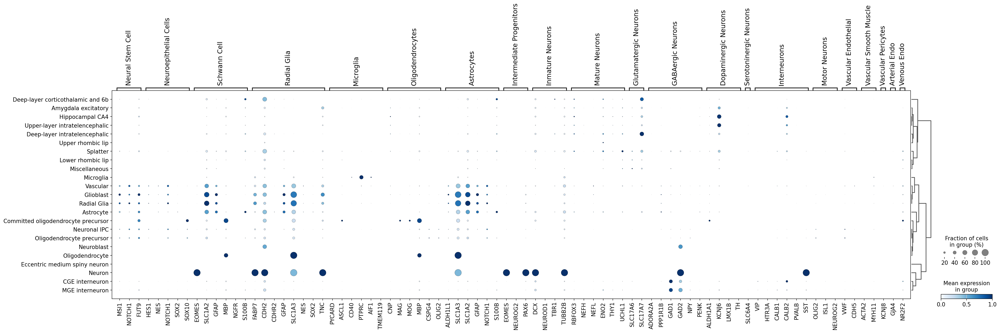

In [41]:
sc.pl.dotplot(
    nmr_adata,
    literature_markers1,
    groupby='Supercluster_pred',
    dendrogram=True,
    color_map="Blues",
    swap_axes=False,
    use_raw=True,
    standard_scale="var",
    save=f'{region}_v{rev_n}_literature_markers1.png'
)

In [42]:
nmr_adata.var[nmr_adata.var_names.str.contains('Shh', case= False)]

,ribo-human_adult,n_cells_by_counts-human_adult,mean_counts-human_adult,log1p_mean_counts-human_adult,pct_dropout_by_counts-human_adult,total_counts-human_adult,log1p_total_counts-human_adult,n_cells-human_adult,global_name-human_adult,Chromosome-human_adult,...,mt,n_cells_by_counts,mean_counts,pct_dropout_by_counts,total_counts,highly_variable,highly_variable_rank,means,variances,variances_norm
global_name,,,,,,,,,,,,,,,,,,,,,


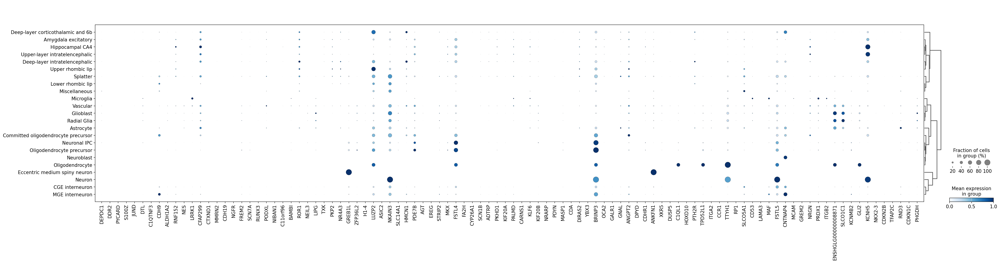

In [43]:
sc.pl.dotplot(
    nmr_adata,
    nmr_adata.var.sort_values(by= 'highly_variable_rank')[800:900].index.to_list(),
    groupby='Supercluster_pred',
    dendrogram=True,
    color_map="Blues",
    swap_axes=False,
    use_raw=True,
    standard_scale="var",
    # save=f'{region}_v{rev_n}_HVG_subset_for_markers.png'
)

In [44]:
literature_markers2 = {
    'Neural progenitor': ['MKI67', 'TOP2A', 'RRM2', 'TPX2'], # not found: 'CCNA2', 'HMGB2' , 'PKB',
    'Neuron':['SLC17A7', 'MAP3K5'],
    'GABAergic':['GAD1','GAD2'],
    'Astrocyte':['GFAP', 'AQP4'],
    'Oligodendrocyte precursor':['PDGFRA' ],
    'Schwann Cells': ['NCAM2','S100B' ],
    'Neuroepithelial cells': ['CDH6'],
    'Microglia': ['TP53BP2', 'CD40','TMEM119', 'CX3CR1', 'ARC', 'SPARC'],
    'Others': ['DCX'],
    'HVG': ['SIX3', 'RETN', 'CD300A', 'LAMP5', 'HS3ST2', 'BMP5', 'TSHZ1', 'NES',
       'HLA-DRA', 'CENPK', 'RBM20', 'PDGFRB', 'FAM124B', 'TMIGD3', 'MGAT4C',
       'IQGAP2', 'H1-4', 'GALNTL6', 'TOX', 'DKK2', 'CYBA', 'PYCARD', 'PRRX1',
       'CD9', 'RRAD', 'EREG', 'PARD3B', 'COL4A5', 'PCBP3', 'PPP1R1C', 'FEZF1',
       'PRDX1', 'KCNS3', 'PDZD2', 'CD44', 'CCDC141', 'PREX2', 'FREM2', 'DPYD',
       'CALCRL', 'NR4A2', 'LRRK1', 'DLC1', 'CDH7', 'TCF15', 'TPBG', 'STC1',
       'CRYM', 'OSTN', 'TH']
}

In [45]:
chosen_hvg_markers = {
    'Neuroblast':['COL24A1', 'GRIN3A', 'MYO5B', 'CNTN5'],
    'Schwann Cells': ['NCAM2'],
    'Neuron':['SPHKAP','LAMA2','KLHL1','ADAMTSL1','RORB', 'RSPO3','CDH6','HOMER1','C8orf34','TSHZ2'],
    'Hippocampal CA1-3': ['IL1RAPL2','PCSK5','SLC17A7', 'TACR1', 'FBN2'],
    'Mature neurons':['DLC1','PDZD2','HPSE2','S100B'],
    'Microglia': ['LRMDA', 'F13A1', 'ARHGAP24', 'CD36', 'AGBL1', 'DOCK8', 'ZC3HAV1', 'HMGA2', 'INPP5D'],
    'Oligodendrocyte': ['COLEC12','CD9', 'SEMA5A','IER3', 'PLP1', 'IGF2'],
    'Committed OP':['GPR17'],
    'Oligodendrocyte precursor':['LHFPL3','PCDH15','ITPR2','DOCK10','PDGFRA'],
    'Astrocyte':['SLC1A3','GLI3','GLIS3', 'GFAP', 'PREX2'],
    'Glioblast':['PTN'],
    'CGE interneuron': ['RELN', 'GALNTL6'],
    'MGE interneuron': ['ERBB4', 'KIAA1217', 'SGCZ','NXPH1', 'GRIK1', 'GAD2','ZNF385D', 'GAD1', 'BIRC5', 'ALK', 'PTCHD4', 'RAB3B'],
    'Eccentric medium spiny neuron':['PBX3','GRM8', 'TRPM3','HTR2C','VWC2L','VAV3', 'VAT1L'],
    'Others': ['EYA1', 'FREM1', 'FOXP2'],
    
}

In [46]:
nmr_adata

AnnData object with n_obs × n_vars = 24378 × 4000
    obs: 'species', 'sample_id', 'region', 'donor_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_tf', 'log1p_total_counts_tf', 'pct_counts_tf', 'n_counts', 'qc_composite', 'qc_label', 'suspension_type', 'dissection', 'total_UMIs', 'cluster_id', 'roi', 'dataset_source', 'stage', 'Major Field', 'Supercluster', 'Specific', 'Top Enriched Genes', 'Age', 'CellClass', 'Region', 'Subregion', 'cell_cycle_score', 'total_genes', 'dataset', '_scvi_batch', '_scvi_labels', 'Supercluster_pred'
    var: 'ribo-human_adult', 'n_cells_by_counts-human_adult', 'mean_counts-human_adult', 'log1p_

categories: Amygdala excitatory, Astrocyte, CGE interneuron, etc.
var_group_labels: Neuroblast, Schwann Cells, Neuron, etc.


/tmp/ipykernel_2797090/1274763100.py:1: FutureWarning: Argument `save` is deprecated and will be removed in a future version. Use `sc.pl.plot(show=False).figure.savefig()` instead.
  sc.pl.dotplot(


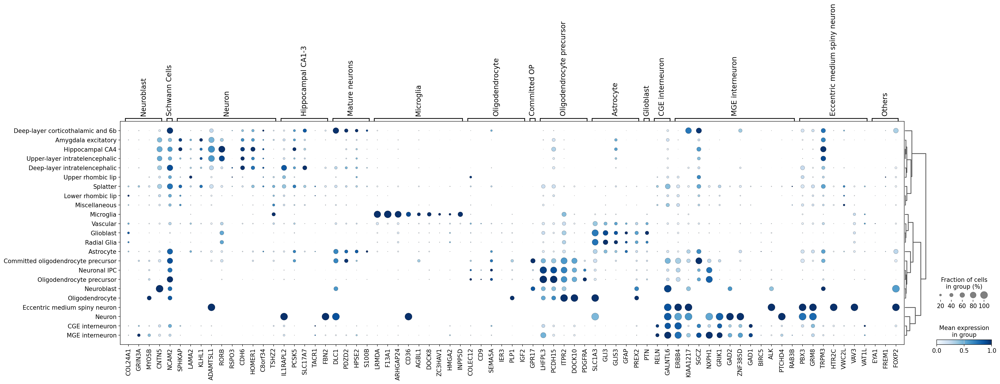

In [47]:
sc.pl.dotplot(
    nmr_adata,
    chosen_hvg_markers,
    groupby='Supercluster_pred',
    dendrogram=True,
    color_map="Blues",
    swap_axes=False,
    use_raw=True,
    standard_scale="var",
    save=f'{region}_v{rev_n}_chosen_HVG_for_markers.png'
)

In [48]:
more_markers = {'0': ['DGKH', 'UBE2E3', 'CHST15'],
 '1': ['PDZD2', 'PRKAR2B', 'GRM3'],
 '2': ['KCNJ6', 'KCNH5', 'ANTXR1'],
 '3': ['GLI3', 'IQGAP2', 'ENSHGLG00000017391'],
 '4': ['ENSHGLG00000010365', 'YWHAG', 'HMGB1'],
 '5': ['PCSK2', 'VIPR1'],
 '6': ['CCSER1'],
 '7': ['NXPH1', 'PPIP5K2', 'TMEM132C'],
 '8': ['CXXC4', 'LRFN5', 'GPC6'],
 '9': ['SCN10A', 'HTR2C', 'BAIAP3'],
 '10': ['NETO1', 'TMEM164', 'PPP4R4'],
 '11': ['TRPS1', 'NEBL', 'TENM1'],
 '12': ['KCNN2', 'NRP1', 'ST6GALNAC5'],
 '13': ['SULF1', 'CDH11', 'LMO3'],
 '14': ['ADARB2', 'HAT1'],
 '15': ['B9D1', 'HLCS', 'STK32A'],
 '16': ['SORCS1', 'ENSHGLG00000013769', 'ENSHGLG00000019205'],
 '17': ['NDST4', 'ENSHGLG00000015791', 'HGF'],
 '18': ['TSHZ2', 'TRIQK', 'TENM2'],
 '19': ['KIAA1217', 'SDK2', 'GAS7'],
 '20': ['ANKFN1', 'ENSHGLG00000005632', 'NR2F2'],
 '21': ['KCNH8', 'SEMA3C', 'PRKG1'],
 '22': ['TMEM132C', 'PPIP5K2', 'LHX6'],
 '23': ['NTNG2', 'TLL1', 'ATP10A'],
 '24': ['TGFBR2', 'FLI1'],
 '25': ['STAC', 'TRMT9B', 'GADL1'],
 '26': ['TP73', 'EBF3', 'ESR1']}

categories: Amygdala excitatory, Astrocyte, CGE interneuron, etc.
var_group_labels: 0, 1, 2, etc.


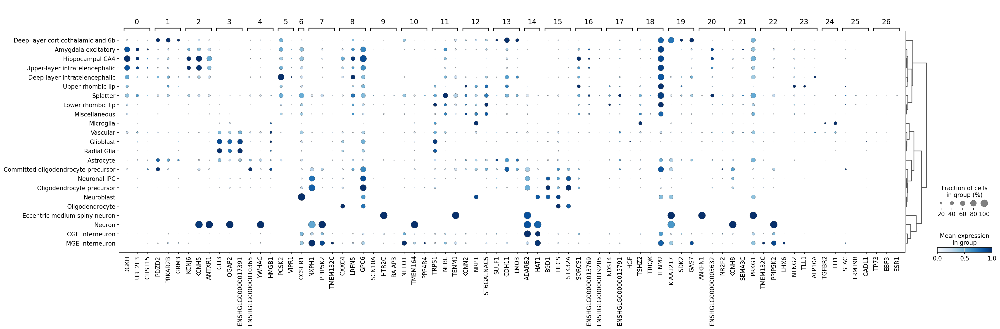

In [49]:
sc.pl.dotplot(
    nmr_adata,
    more_markers,
    groupby='Supercluster_pred',
    dendrogram=True,
    color_map="Blues",
    swap_axes=False,
    use_raw=True,
    standard_scale="var",
    
)

In [50]:
full_de = scanvi_model.differential_expression(groupby='Supercluster_pred')


DE...: 100%|██████████| 35/35 [02:20<00:00,  4.01s/it]


In [51]:
full_de

,proba_m1,proba_m2,bayes_factor,scale1,scale2,raw_mean1,raw_mean2,non_zeros_proportion1,non_zeros_proportion2,raw_normalized_mean1,raw_normalized_mean2,comparison,group1,group2
global_name,,,,,,,,,,,,,,
L3MBTL3,0.9348,0.0652,2.662873,0.000463,0.000172,0.467085,0.225665,0.243374,0.143832,6.445892,1.483942,Amygdala excitatory vs Rest,Amygdala excitatory,Rest
PTPRK,0.9286,0.0714,2.565380,0.008875,0.003369,10.035908,3.737507,0.794243,0.497627,96.856313,26.534628,Amygdala excitatory vs Rest,Amygdala excitatory,Rest
CNTN3,0.9206,0.0794,2.450527,0.004812,0.001465,2.995440,1.818750,0.661727,0.367507,47.611315,12.869662,Amygdala excitatory vs Rest,Amygdala excitatory,Rest
POSTN,0.9178,0.0822,2.412824,0.000543,0.000137,0.190368,0.083999,0.100598,0.033941,5.814922,1.048074,Amygdala excitatory vs Rest,Amygdala excitatory,Rest
TAFA1,0.9168,0.0832,2.399642,0.018642,0.005362,11.457395,5.358410,0.929895,0.402366,181.157267,42.724069,Amygdala excitatory vs Rest,Amygdala excitatory,Rest
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ROBO1,0.0874,0.9126,-2.345802,0.000620,0.002547,0.252475,6.650224,0.137907,0.541989,3.674661,27.090869,Vascular vs Rest,Vascular,Rest
SYN2,0.0732,0.9268,-2.538542,0.000085,0.000714,0.034653,2.283050,0.028289,0.357325,0.479060,7.106056,Vascular vs Rest,Vascular,Rest
KCNG1,0.0676,0.9324,-2.624154,0.000013,0.000065,0.002122,0.118648,0.002122,0.072623,0.010697,0.448699,Vascular vs Rest,Vascular,Rest


In [52]:
auto_markers = {}
cats = full_de['group1'].unique()
for i, c in enumerate(cats):
    # Filter results for this cluster
    cluster_df = full_de[full_de['group1'] == c].copy()
    cluster_df = cluster_df.sort_values("bayes_factor", ascending=False)

    # significance threshold
    cluster_df = cluster_df[cluster_df["bayes_factor"] > 2]
    # genes with sufficient expression
    cluster_df = cluster_df[cluster_df["non_zeros_proportion1"] > 0.1]

    auto_markers[c] = cluster_df.index.tolist()[:3]

In [53]:
auto_markers

{'Amygdala excitatory': ['L3MBTL3', 'PTPRK', 'CNTN3'],
 'Astrocyte': ['ITGA7', 'PAPLN', 'RANBP3L'],
 'CGE interneuron': ['PROX1', 'NDNF', 'TNFAIP8L3'],
 'Cerebellar inhibitory': ['ANKRD29', 'SYT2', 'KCNJ3'],
 'Choroid plexus': ['PPP1R36', 'RNF217', 'PIR'],
 'Committed oligodendrocyte precursor': ['VSTM2B', 'SCD5', 'SNX22'],
 'Deep-layer corticothalamic and 6b': ['DLC1', 'PDE1A', 'ZFPM2'],
 'Deep-layer intratelencephalic': ['STX1A', 'TRPC5', 'ADTRP'],
 'Deep-layer near-projecting': ['CDCP1', 'ITGA8', 'CRYM'],
 'Eccentric medium spiny neuron': ['TSHZ1', 'DRD1', 'GRM4'],
 'Fibroblast': ['ISLR', 'FAP', 'PCOLCE'],
 'Glioblast': ['CDON', 'LIPG', 'CNTFR'],
 'Hippocampal CA1-3': ['CLDN16', 'TMT1B', 'CLEC2L'],
 'Hippocampal CA4': ['SLC2A13', 'KCNJ6', 'POSTN'],
 'Hippocampal dentate gyrus': ['FGF5', 'CBLN2', 'CRHR2'],
 'LAMP5-LHX6 and Chandelier': ['EYA4', 'ANO1', 'CA3'],
 'Lower rhombic lip': ['NRP1'],
 'MGE interneuron': ['LHX6', 'ELAVL2', 'CACNA2D2'],
 'Mammillary body': ['ESRRG', 'RAB37', 'C

categories: Amygdala excitatory, Astrocyte, CGE interneuron, etc.
var_group_labels: Amygdala excitatory, Astrocyte, CGE interneuron, etc.


/tmp/ipykernel_2797090/1769526728.py:1: FutureWarning: Argument `save` is deprecated and will be removed in a future version. Use `sc.pl.plot(show=False).figure.savefig()` instead.
  sc.pl.dotplot(


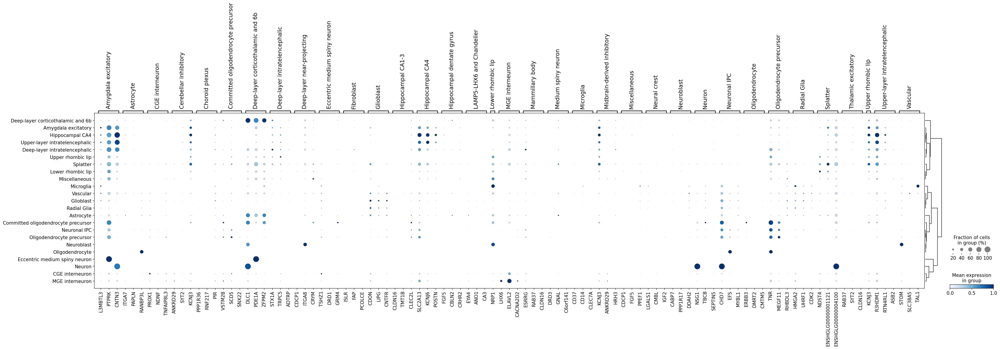

In [54]:
sc.pl.dotplot(
    nmr_adata,
    auto_markers,
    groupby='Supercluster_pred',
    dendrogram=True,
    color_map="Blues",
    swap_axes=False,
    use_raw=True,
    standard_scale="var",
    save=f'{region}_v{rev_n}_automatic_scVI_markers.png'
)

In [55]:
all_markers = []
for lst1 in chosen_hvg_markers.values():
    all_markers.extend(lst1)

Neuroblast


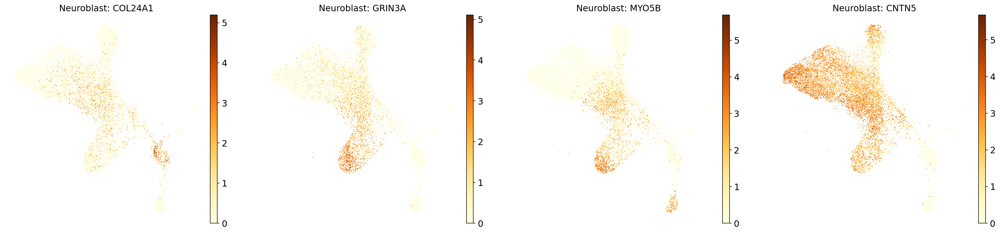

Schwann Cells


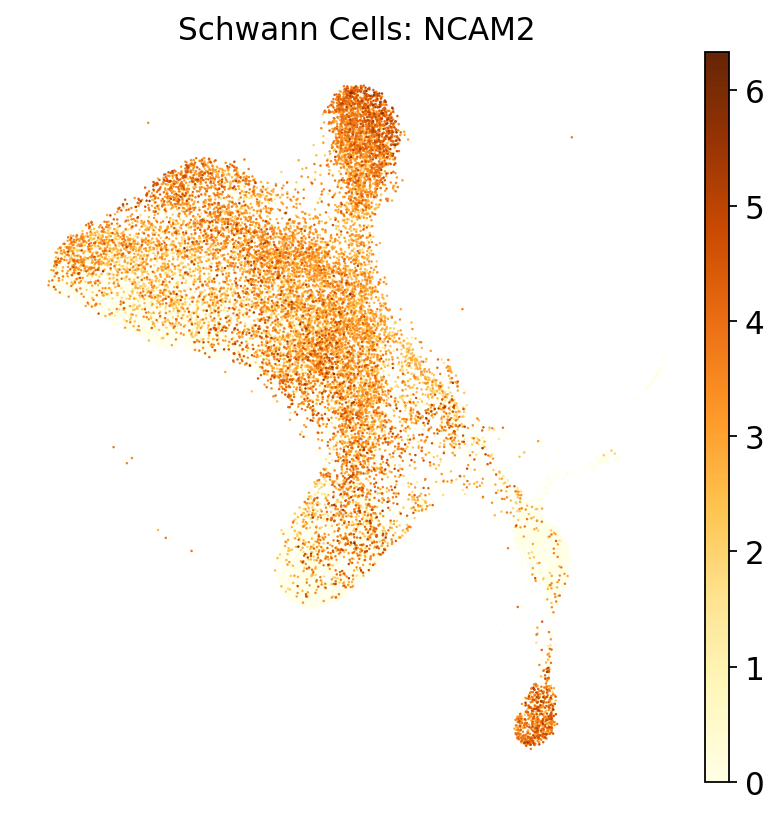

Neuron


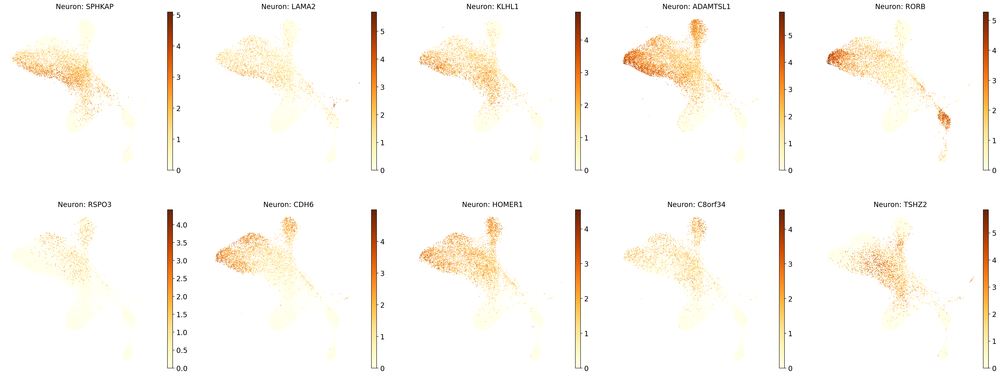

Hippocampal CA1-3


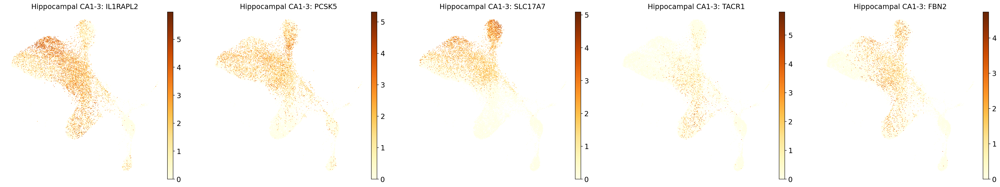

Mature neurons


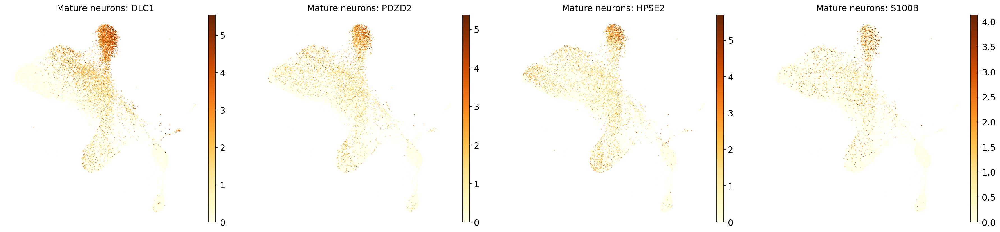

Microglia


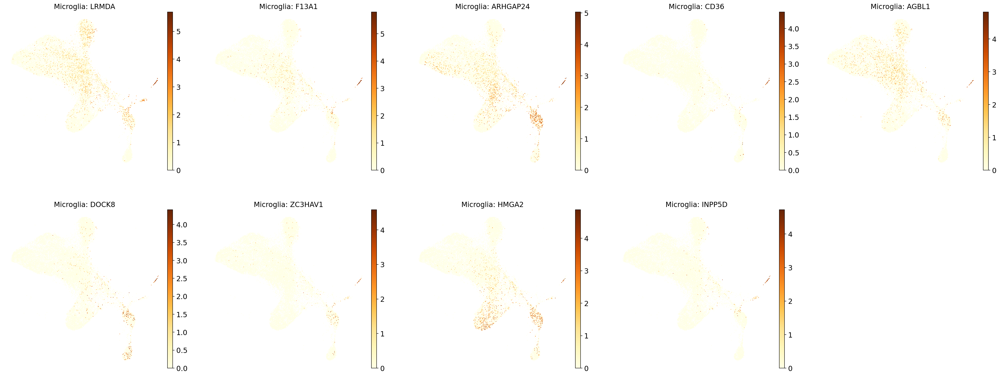

Oligodendrocyte


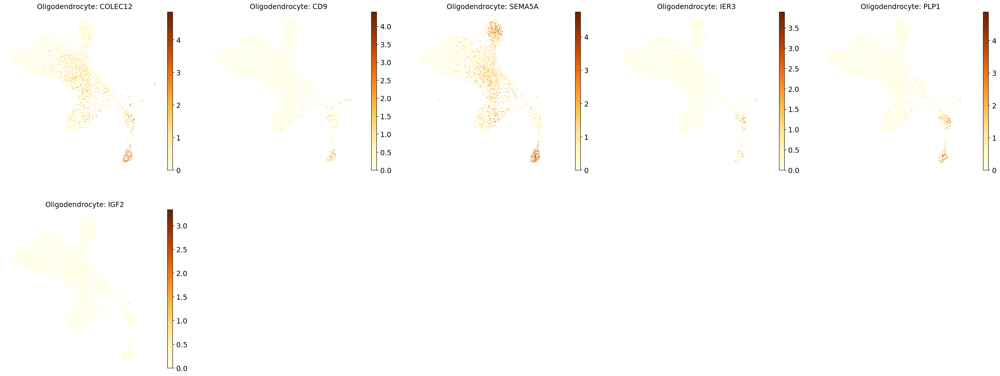

Committed OP


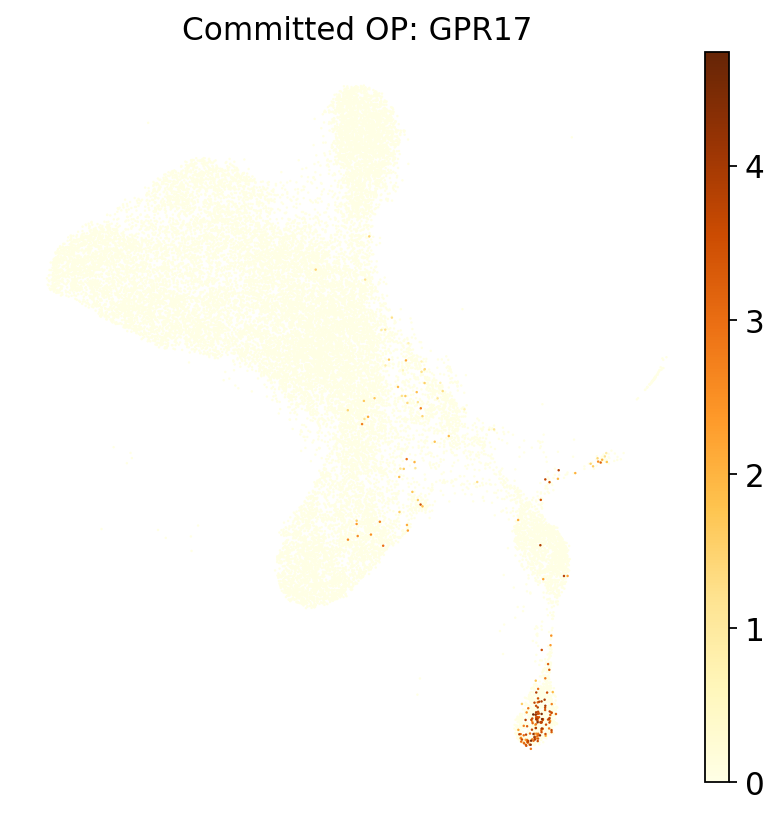

Oligodendrocyte precursor


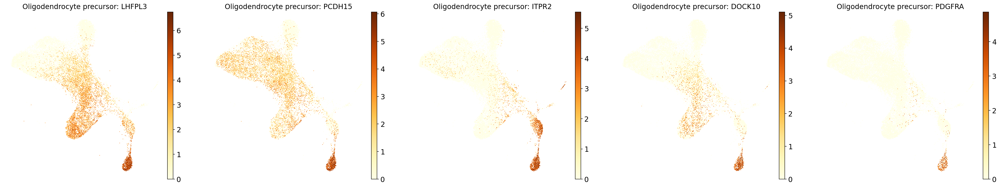

Astrocyte


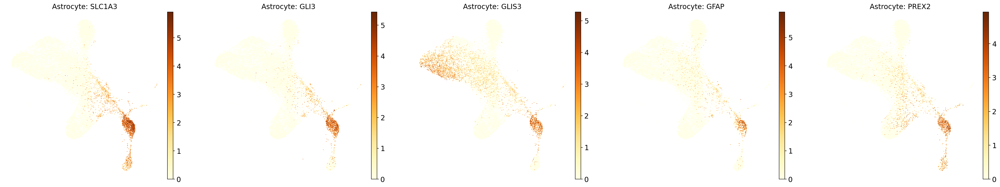

Glioblast


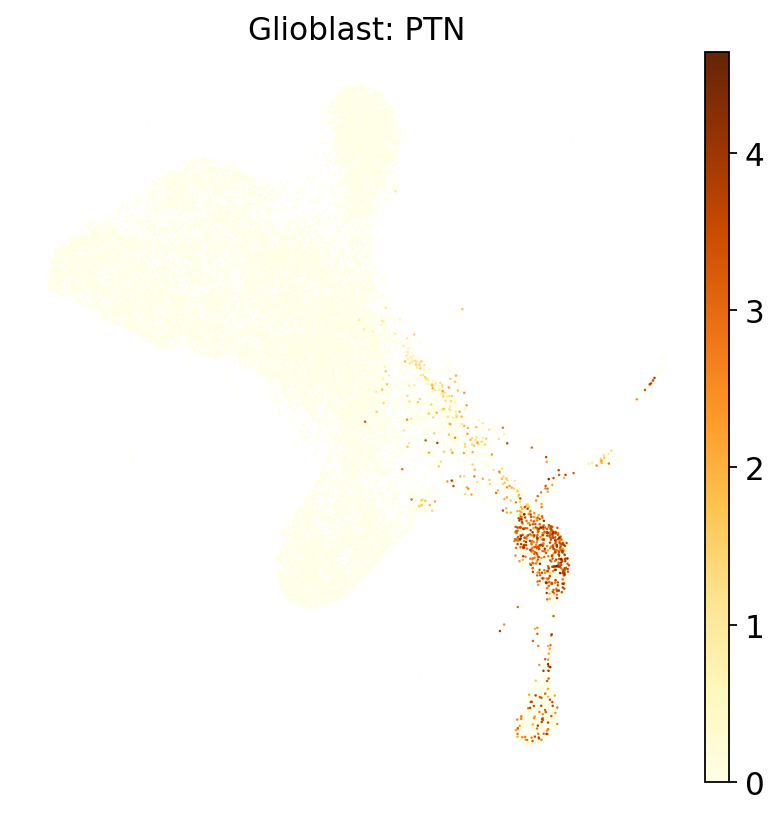

CGE interneuron


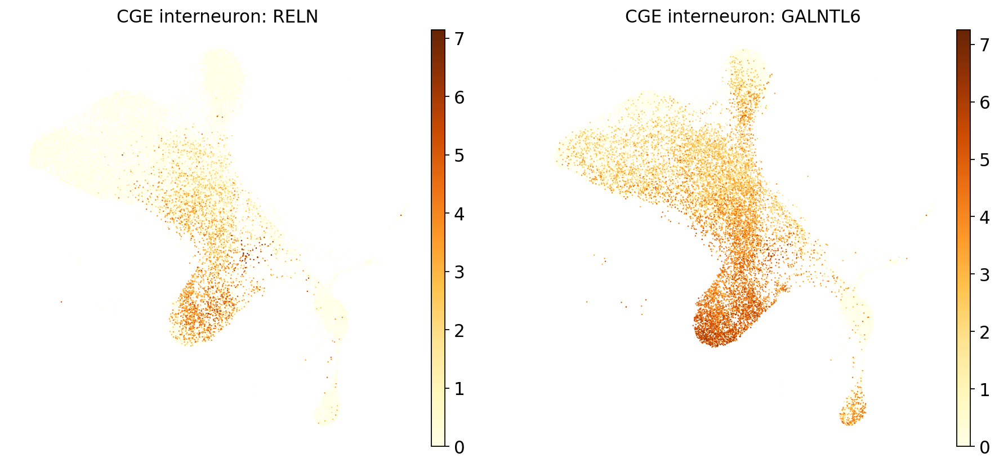

MGE interneuron


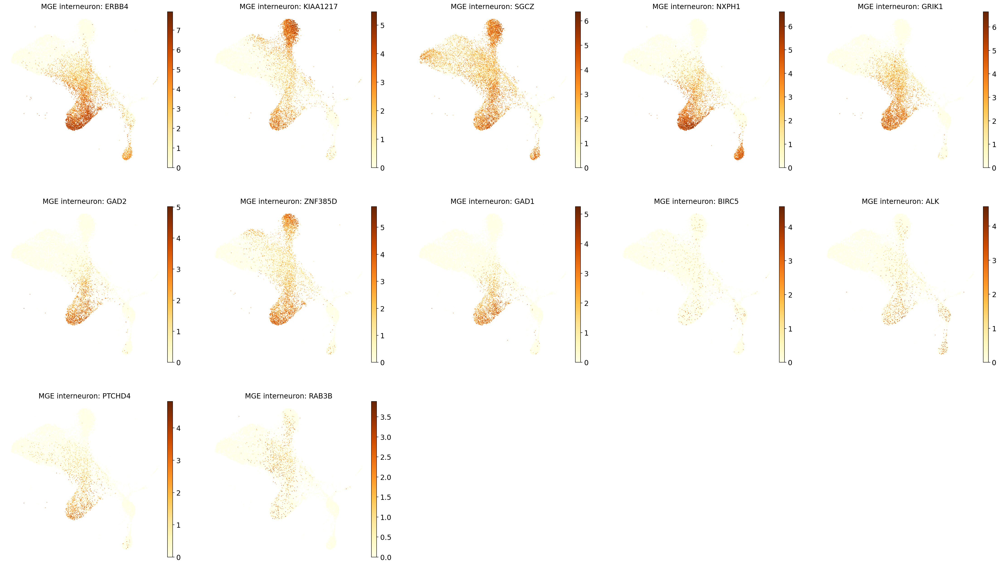

Eccentric medium spiny neuron


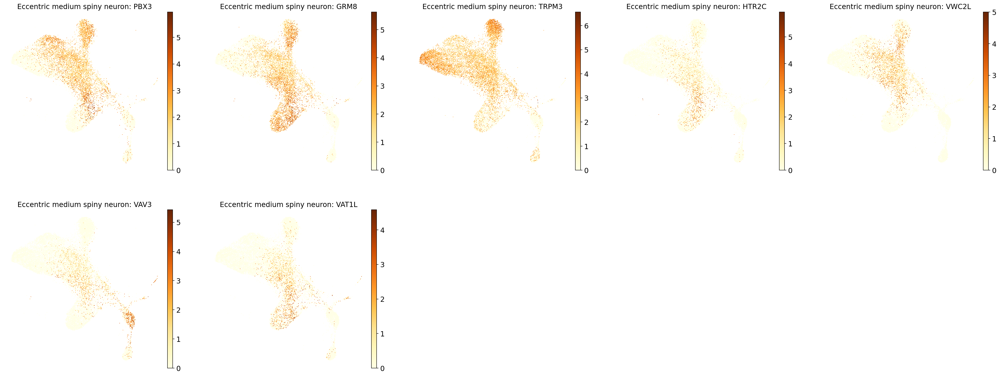

Others


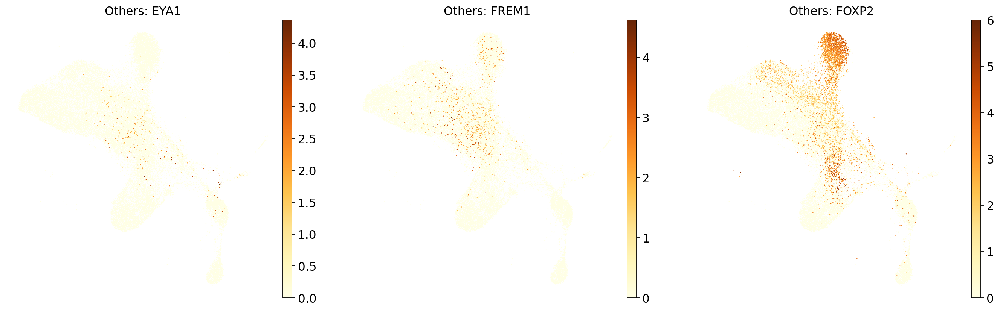

In [56]:
for key,lst in chosen_hvg_markers.items():
    print(key)
    titles = [f'{key}: {marker}' for marker in lst]
    sc.pl.umap(nmr_adata, color=lst, color_map='YlOrBr', ncols=5 ,
               title = titles,
           #save=f'_{region}_v{rev_n}_marker_expression_{key}.png' #layer="scvi_expr"
)


In [57]:
sc.pl.umap(nmr_adata, color=all_markers, color_map='YlOrBr', ncols=5 ,
           save=f'_{region}_v{rev_n}_marker_expression.png' #layer="scvi_expr"
)

/tmp/ipykernel_2797090/876218405.py:1: FutureWarning: Argument `save` is deprecated and will be removed in a future version. Use `sc.pl.plot(show=False).figure.savefig()` instead.
  sc.pl.umap(nmr_adata, color=all_markers, color_map='YlOrBr', ncols=5 ,


In [58]:
nmr_adata.var.drop(['ribo-human_adult', 'n_cells_by_counts-human_adult', 'mean_counts-human_adult', 'log1p_mean_counts-human_adult', 'pct_dropout_by_counts-human_adult', 'total_counts-human_adult', 'log1p_total_counts-human_adult', 'n_cells-human_adult', 'global_name-human_adult', 'Chromosome-human_adult', 'End-human_adult', 'Gene-human_adult', 'Start-human_adult', 'Strand-human_adult', 'human_gene_name-human_adult', 'ribo-human_dev', 'n_cells_by_counts-human_dev', 'mean_counts-human_dev', 'log1p_mean_counts-human_dev', 'pct_dropout_by_counts-human_dev', 'total_counts-human_dev', 'log1p_total_counts-human_dev', 'n_cells-human_dev', 'global_name-human_dev', 'Chromosome-human_dev', 'End-human_dev', 'Gene-human_dev', 'Start-human_dev', 'human_gene_name-human_dev', 'GeneTotalUMIs-human_dev'], 
                   axis=1,inplace=True)

In [59]:
nmr_adata

AnnData object with n_obs × n_vars = 24378 × 4000
    obs: 'species', 'sample_id', 'region', 'donor_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_tf', 'log1p_total_counts_tf', 'pct_counts_tf', 'n_counts', 'qc_composite', 'qc_label', 'suspension_type', 'dissection', 'total_UMIs', 'cluster_id', 'roi', 'dataset_source', 'stage', 'Major Field', 'Supercluster', 'Specific', 'Top Enriched Genes', 'Age', 'CellClass', 'Region', 'Subregion', 'cell_cycle_score', 'total_genes', 'dataset', '_scvi_batch', '_scvi_labels', 'Supercluster_pred'
    var: 'ribo-nmr', 'n_cells_by_counts-nmr', 'mean_counts-nmr', 'log1p_mean_counts-nmr', 'pct_d

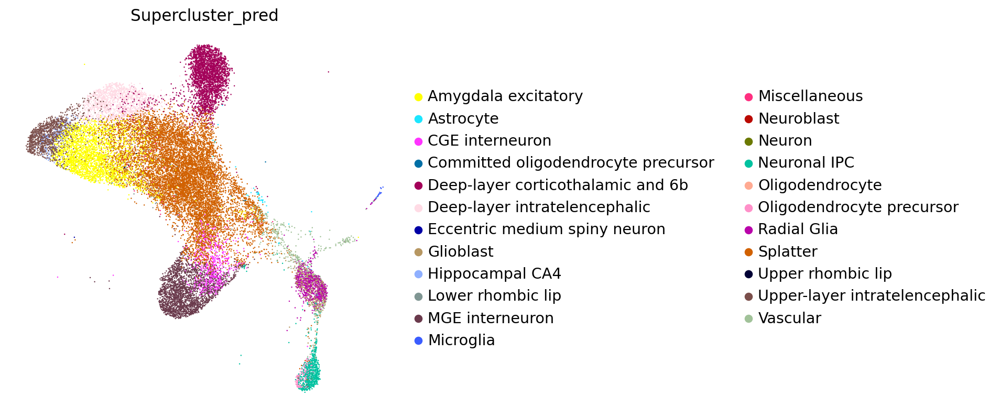

In [60]:
sc.pl.umap(nmr_adata, color='Supercluster_pred')

In [61]:
sc.pp.neighbors(nmr_adata, n_neighbors=20, use_rep = 'X_scVI')


In [62]:
sc.tl.leiden(nmr_adata, resolution = 0.8)

/tmp/ipykernel_2797090/1726794372.py:1: FutureWarning: The `igraph` implementation of leiden clustering is *orders of magnitude faster*. Set the flavor argument to (and install if needed) 'igraph' to use it.
In the future, the default backend for leiden will be igraph instead of leidenalg. To achieve the future defaults please pass: `flavor='igraph'` and `n_iterations=2`. `directed` must also be `False` to work with igraph’s implementation.
  sc.tl.leiden(nmr_adata, resolution = 0.8)


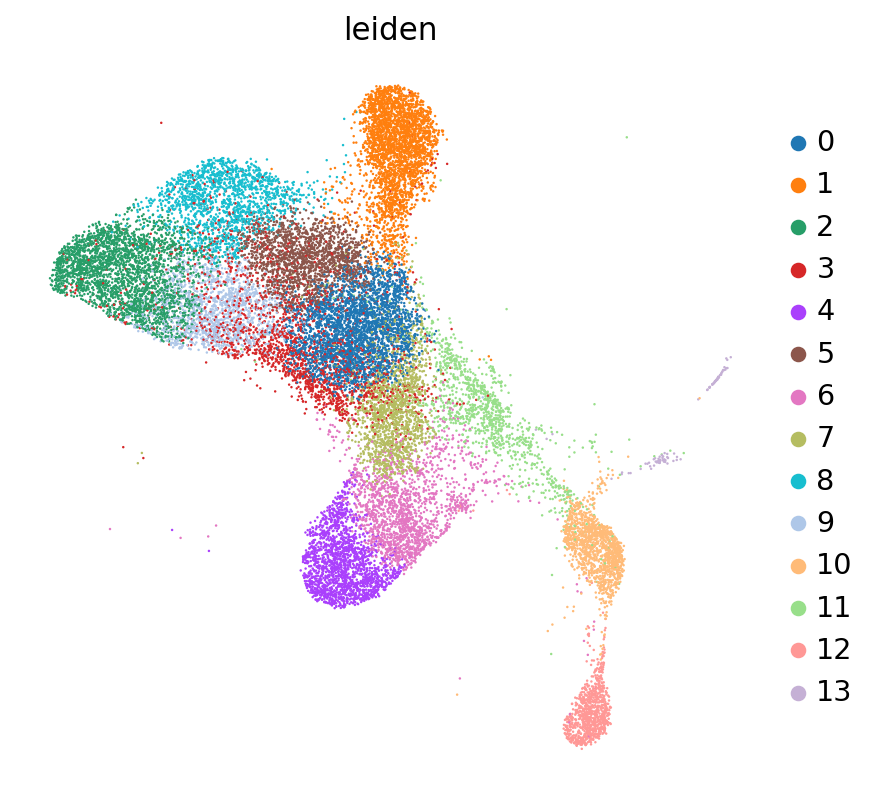

In [63]:
sc.pl.umap(nmr_adata, color = 'leiden')

/tmp/ipykernel_2797090/3525243947.py:1: UserWarning: You’re trying to run this on 4000 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  sc.pl.dotplot(nmr_adata, chosen_hvg_markers, groupby= 'leiden', dendrogram=True)


categories: 0, 1, 2, etc.
var_group_labels: Neuroblast, Schwann Cells, Neuron, etc.


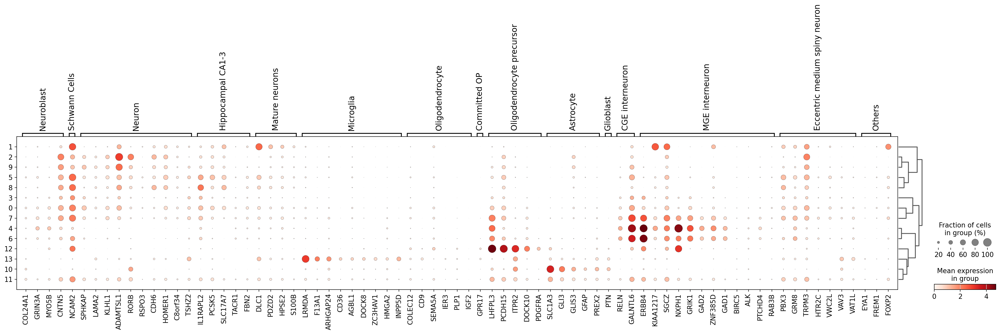

In [64]:
sc.pl.dotplot(nmr_adata, chosen_hvg_markers, groupby= 'leiden', dendrogram=True)

In [65]:
nmr_adata

AnnData object with n_obs × n_vars = 24378 × 4000
    obs: 'species', 'sample_id', 'region', 'donor_id', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'total_counts_tf', 'log1p_total_counts_tf', 'pct_counts_tf', 'n_counts', 'qc_composite', 'qc_label', 'suspension_type', 'dissection', 'total_UMIs', 'cluster_id', 'roi', 'dataset_source', 'stage', 'Major Field', 'Supercluster', 'Specific', 'Top Enriched Genes', 'Age', 'CellClass', 'Region', 'Subregion', 'cell_cycle_score', 'total_genes', 'dataset', '_scvi_batch', '_scvi_labels', 'Supercluster_pred', 'leiden'
    var: 'ribo-nmr', 'n_cells_by_counts-nmr', 'mean_counts-nmr', 'log1p_mean_counts-nm

In [67]:
nmr_adata.obs['Supercluster_pred'].to_csv('scanvi_pred.csv')

In [68]:
adata.write_h5ad(f"/home/ratopin/big_data/combined/cerebral_cortex{rev_n}_scanvi_annotated.h5ad")

## Standard workflow

The standard workflow consists of

1. Feature-wise scaling
2. Principal components analysis
3. Neighbor graph computation


In [21]:
sc.pp.scale(adata) # z normalize the columns (genes)
sc.tl.pca(adata)

/home/ratopin/miniconda3/envs/scanpy-env/lib/python3.12/functools.py:912: UserWarning: zero-centering a sparse array/matrix densifies it.
  return dispatch(args[0].__class__)(*args, **kw)


In [22]:
adata.obsm["X_pca"].shape

(63605, 50)

In [23]:
sc.pp.neighbors(adata, n_neighbors= 35) # compute nearest neighbors
sc.tl.umap(adata)

In [24]:
adata.obsm["X_umap"]

array([[ 6.083253 , 14.237587 ],
       [10.834343 , 12.378005 ],
       [12.538153 ,  9.482988 ],
       ...,
       [-5.8236823, 16.38734  ],
       [-5.907403 , 16.3861   ],
       [-5.724055 , 16.295715 ]], shape=(63605, 2), dtype=float32)

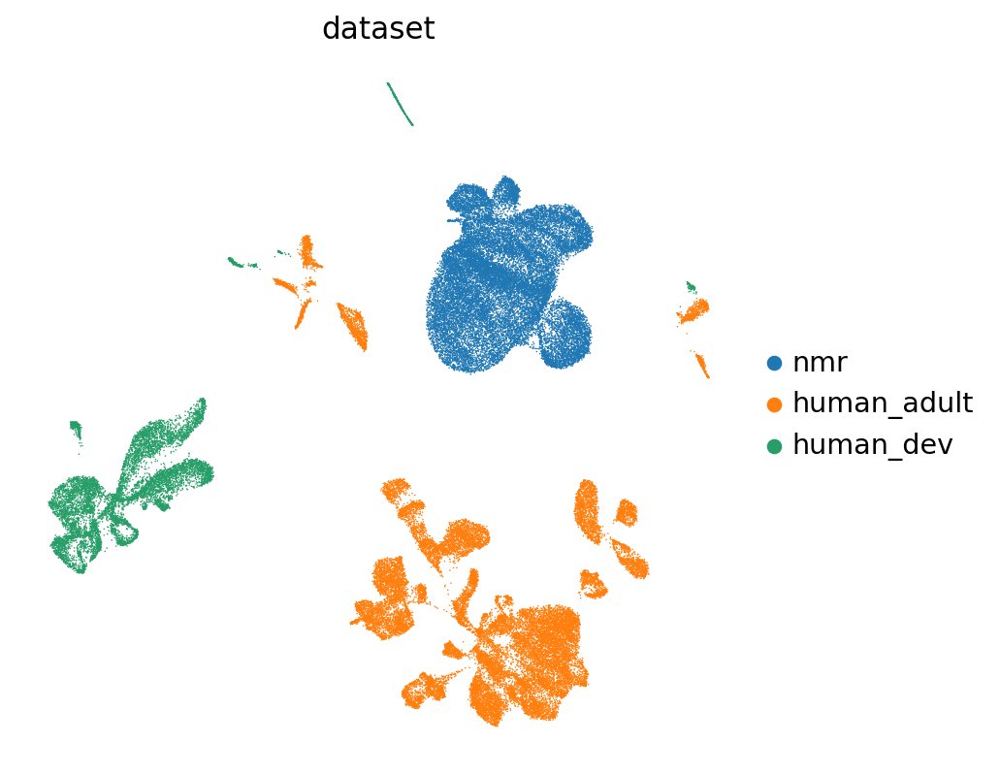

In [25]:
sc.pl.umap(adata, color="dataset")

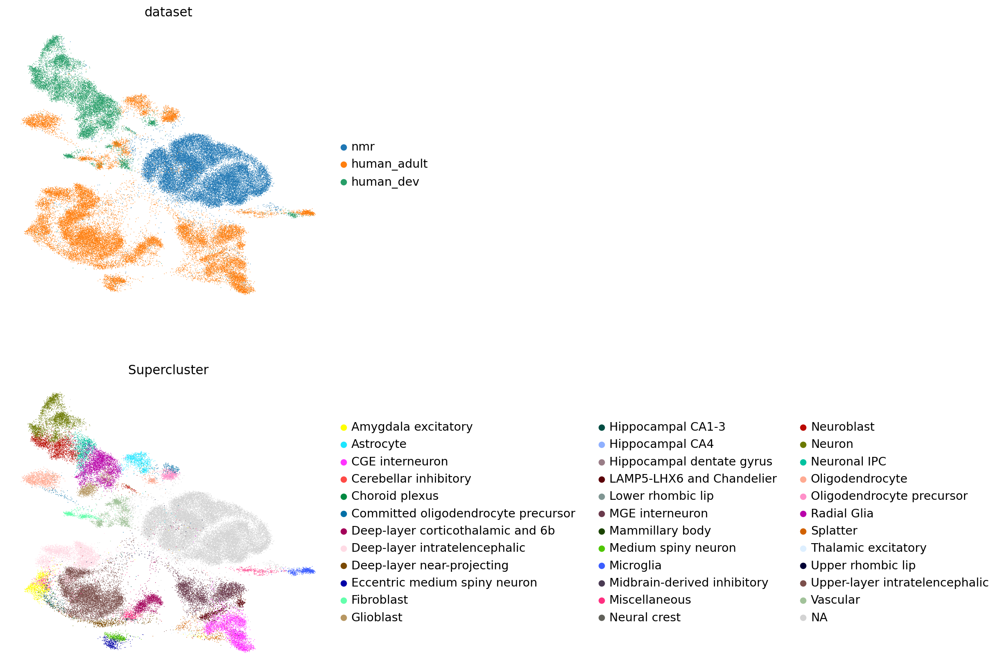

In [ ]:
import scanpy.external as sce
sce.pp.bbknn(adata, batch_key="dataset")
sc.tl.umap(adata)


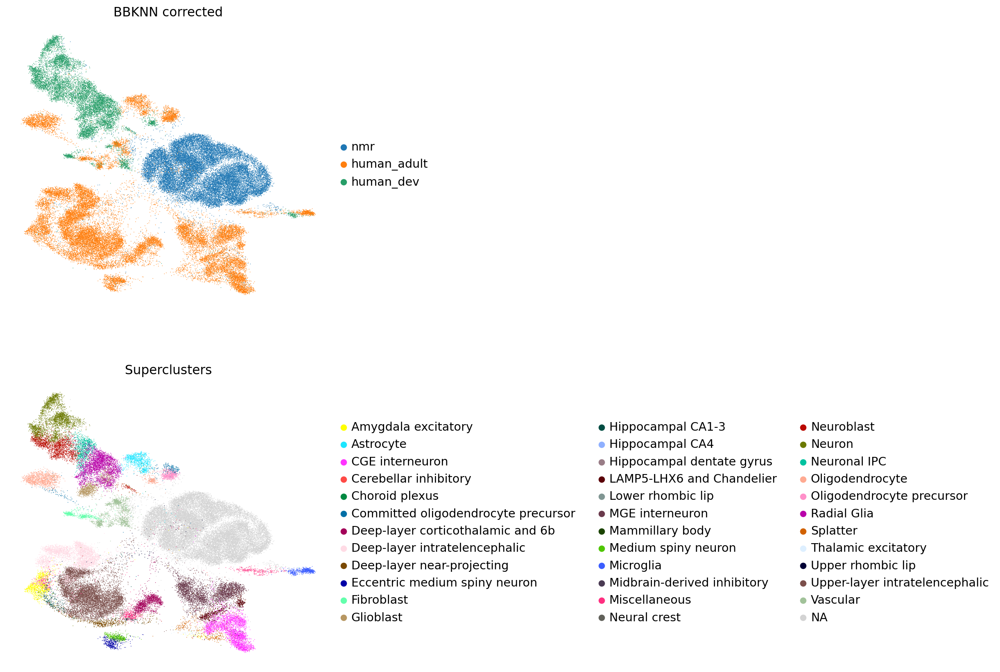

In [42]:
sc.pl.umap(adata, color=["dataset", "Supercluster"], title=['BBKNN corrected', 'Superclusters'], ncols=1)

### scVI DE

The **`change`** mode follows protocol described in [Boyeau et al](https://www.biorxiv.org/content/10.1101/794289v1).

We are comparing $h_{1g}$, the "decoded" expression of gene $g$ in cell type 1, with $h_{2g}$, the "decoded" expression of $g$ in cell type 2.
    
The hypotheses are:

$$
M^g_1: |f(h_{1g}, h_{2g})|  > \delta
$$

$$
M^g_0: |f(h_{1g}, h_{2g})| \leq \delta
$$

where $\delta$ is a user-defined effect size threshold, and $f$ is the log fold change of experssion.

DE "significance" between cell types 1 and 2 for each gene can then be based on the Bayes factors:

$$
\text{Natural Log Bayes Factor for gene g in cell types 1 and 2} = \ln ( {BF^g_{10}) = \ln(\frac{ p(M^g_1 | x_1, x_2)}{p(M^g_0 | x_1, x_2)}})
$$

**Note that the scvi returns the _natural logarithm_ of the Bayes Factor.  
